In [26]:
import geopandas as gpd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import contextily as ctx
import shapely
from shapely import wkt
import openpyxl
import pyproj
import re

In [27]:
# Functions

# Naming files using the key
def convertTuple(tup): 
    str =  '_'.join((tup[1],tup[0])) 
    return str

def convertTuple2(tup): 
    str =  '_'.join(tup) 
    return str

def get_wkt(geom):
    return shapely.wkt.loads()

In [28]:
# File paths
## -- Hamilton City Shape Files
fp_stops = r'G:\Hamilton\Data\City Model\2016 Hamilton Shp files\stops.shp'
fp_direction_stops = r'G:\Hamilton\Data\City Model\2016 Hamilton Shp files\direction_stops.dbf'
fp_directions= r'G:\Hamilton\Data\City Model\2016 Hamilton Shp files\directions.dbf'

## -- Hamilton 2016 Headway Sheet
fp_headway_sht = r'G:\Hamilton\Data\City Model\Fall 2016 - Headways.csv'
fp_2016_hamilton = r'G:\Hamilton\Data\City Model\CityProvidedShapeFilesRoutes.xlsx'

## -- Emme GTA Model
fp_emme_nodes = r'G:\Hamilton\Data\Emme Model\Scenario_8\emme_nodes.shp'
fp_emme_tlines =r'G:\Hamilton\Data\Emme Model\Scenario_8\emme_tlines.shp'
fp_emme_tseg = r'G:\Hamilton\Data\Emme Model\Scenario_8\emme_tsegs.shp'
#fp_emme_tlines_csv = r'G:\Hamilton\Data\Emme Model\Scenario_8\hamilton_emme_tlines.csv'
#fp_hamilton_convexhull = r'C:\Users\mluc0\OneDrive\Desktop\New folder (2)\Hamilton_emme\Convex Hull\HamiltonConvexHull.shp'
 

# -- || City Hamilton Data || -- 
## -- Headway -- 
- Get the Headyway Data and Determine the headways for each pattern and station
- Filter Data for first and last station for each pattern

## -- City Shape Files
- Merge the Transit Lines and stops into one single file to merge with the headway data

In [29]:
# -- Headway -- 
## -- Get the Headyway Data and Determine the headways for each pattern and station
headway_data = pd.read_csv(fp_headway_sht,parse_dates=True).dropna(axis=0, how='all')

headway_data_sequence = headway_data[headway_data.iloc[:,6]=="Sequence"]
headway_data_run = headway_data[~(headway_data.iloc[:,6]=="Sequence")]

dfh1 = headway_data_run.melt(id_vars=['Notes on route', 'Route Name', 'Route No', 'Stop Pattern', 'Direction',
       'Schedule', 'Run/Station Sequence'], var_name='Sequence', value_name='timestamp').dropna(subset=['timestamp'])

dfh1['timestamp'] = pd.to_datetime(dfh1['timestamp'].map('2016-09-04-{}'.format),format='%Y-%m-%d-%H:%M')
dfh1 = dfh1.sort_values(by=['Route No','Stop Pattern','Direction','Schedule','Sequence','timestamp'],ascending=True)

df_list = []
for key, group in dfh1.groupby(['Route No','Route Name','Schedule','Direction','Stop Pattern','Sequence']):
    df_list.append(group['timestamp'].diff())
    

dfh1['deltaT'] = pd.concat(df_list)

dfh2 = headway_data_sequence.melt(id_vars=['Notes on route', 'Route Name', 'Route No', 'Stop Pattern', 'Direction',
       'Schedule', 'Run/Station Sequence'], var_name='Sequence', value_name='StationShortName')


dfh3 = pd.merge(dfh1,dfh2,how='left',left_on=['Route Name', 'Route No', 'Stop Pattern', 'Direction',
       'Schedule','Sequence'], right_on=['Route Name', 'Route No', 'Stop Pattern', 'Direction',
       'Schedule','Sequence'],sort=False)


# Convert deltaT to seconds
dfh3.deltaT = dfh3.deltaT.dt.seconds/60

# data for stop ids
#cols = [1,2,3,4,13]
#dfh4 = dfh3.iloc[:,cols]
#dfh4.drop_duplicates(inplace=True)

## -- Filter Data for first and last station for each pattern

## -- City Shape Files
stops = gpd.read_file(fp_stops)

directions = gpd.read_file(fp_directions)

direction_stops = gpd.read_file(fp_direction_stops)

direction_stops.columns = map(str.lower, direction_stops.columns)

## -- Merge stops with diection_stops
stops_merged = stops.merge(direction_stops, on='stop_id')

## -- Merge all City Shape Files into a single Dataframe
hamilton_shp_data = directions.merge(stops_merged,on='dir_id').sort_values(by=['full_name','dir_name','pattern','distmeters'])

## -- Output City Shape File attribute tables to csv for manual entry of headway data

## -- Merge the Transit Lines and Sstops into one single file to merge with the headway data
## -- Read in updated hamilton_shp_data
hamilton_shp_data_new = pd.read_excel(fp_2016_hamilton,sheet_name='2016_hamilton_routes',engine='openpyxl', usecols = np.arange(0,24))
hamilton_shp_data_new['line_name'] = hamilton_shp_data_new.line_name.str.upper()
hamilton_shp_data_new['StationShortName'] = hamilton_shp_data_new['StationShortName'].str.rstrip('StationShortName').str.lstrip('StationShortName')

dfh3.rename(columns = {'Run/Station Sequence_x':'Run'},inplace=True)

dfh3['line_name'] = dfh3['Route No'].astype('str').str.pad(2,side='left',fillchar="0").str.pad(3,side='right',fillchar=" ") 
dfh3['line_name'] = dfh3.line_name + dfh3['Route Name'].str.rstrip('Route Name').str.lstrip('Route Name')

dfh3.drop(columns=['Notes on route_y','Run'],inplace=True)
dfh3['StationShortName'] = dfh3.StationShortName.str.rstrip('StationShortName').str.lstrip('StationShortName')




In [30]:
dfh3

,Notes on route_x,Route Name,Route No,Stop Pattern,Direction,Schedule,Sequence,timestamp,deltaT,Run/Station Sequence_y,StationShortName,line_name
0,NaN,KING,1,1,Eastbound,WEEKDAY,1,2016-09-04 06:30:00,NaN,Sequence,GO-TERM,01 KING
1,NaN,KING,1,1,Eastbound,WEEKDAY,1,2016-09-04 06:40:00,10.0,Sequence,GO-TERM,01 KING
2,NaN,KING,1,1,Eastbound,WEEKDAY,1,2016-09-04 06:50:00,10.0,Sequence,GO-TERM,01 KING
3,NaN,KING,1,1,Eastbound,WEEKDAY,1,2016-09-04 07:00:00,10.0,Sequence,GO-TERM,01 KING
4,NaN,KING,1,1,Eastbound,WEEKDAY,1,2016-09-04 07:15:00,15.0,Sequence,GO-TERM,01 KING
...,...,...,...,...,...,...,...,...,...,...,...,...
7223,NaN,STONEY CREEK LOCAL,58,2,Westbound,WEEKDAY,4,2016-09-04 09:52:00,30.0,Sequence,KING CENT,58 STONEY CREEK LOCAL
7224,NaN,STONEY CREEK LOCAL,58,2,Westbound,WEEKDAY,4,2016-09-04 10:32:00,40.0,Sequence,KING CENT,58 STONEY CREEK LOCAL
7225,NaN,STONEY CREEK LOCAL,58,2,Westbound,WEEKDAY,5,2016-09-04 09:26:00,NaN,Sequence,EGTE SQRE,58 STONEY CREEK LOCAL
7226,NaN,STONEY CREEK LOCAL,58,2,Westbound,WEEKDAY,5,2016-09-04 09:56:00,30.0,Sequence,EGTE SQRE,58 STONEY CREEK LOCAL


In [31]:
directions.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [32]:
hamilton_shp_data_new = pd.merge(hamilton_shp_data_new, dfh3,how='left',on=['line_name','Direction','StationShortName']).sort_values(by=['full_name','dir_name','pattern','distmeters'])
#hamilton_shp_data_new.to_csv(r'G:\Hamilton\Data\City Model\hamilton_shp_data_new.csv')
hamilton_shp_data_new['Stop Pattern'] = hamilton_shp_data_new['Stop Pattern'].apply(str)

In [33]:
route_groups = hamilton_shp_data_new.groupby(by=['line_name','Direction','pattern'])

keys_list = []
laststation_short_list = []
firststation_short_list = []
laststation_long_list = []
firststation_long_list = []
patterns_list = []

for key, group in route_groups:
    laststation = group[group['distmeters'] == group['distmeters'].max()]
    firststation = group[group['distmeters'] == group['distmeters'].min()]
    keys_list.append(key)
    laststation_short_list.append(laststation['StationShortName'].unique())
    laststation_long_list.append(laststation['stop_name'].unique())
    firststation_short_list.append(firststation['StationShortName'].unique())
    firststation_long_list.append(firststation['stop_name'].unique())
    patterns_list.append(group['Stop Pattern'].unique())

dict = {"Route/Direction/Pattern":keys_list,'Headway Sheet Pattern':patterns_list,"FirstStationShortName":firststation_short_list,"FirstStationLongList":firststation_long_list, "LastStationShortName":laststation_short_list,"LastStationLongList":laststation_long_list}


In [34]:
pd.DataFrame(dict)

,Route/Direction/Pattern,Headway Sheet Pattern,FirstStationShortName,FirstStationLongList,LastStationShortName,LastStationLongList
0,"(01 KING, Eastbound, A)","[1.0, nan, 2.0]",[GO-TERM],[HAMILTON GO CENTRE PLATFORM 18],[EGTE SQRE],[EASTGATE TERMINAL PLATFORM 4]
1,"(01 KING, Eastbound, B)","[1.0, nan, 2.0]",[GO-TERM],[HAMILTON GO CENTRE PLATFORM 18],[nan],[FIESTA MALL LOOP]
2,"(01 KING, Eastbound, C)","[2.0, nan, 1.0]",[UNIV PLZA],[UNIVERSITY PLAZA PLATFORM 1],[EGTE SQRE],[EASTGATE TERMINAL PLATFORM 4]
3,"(01 KING, Eastbound, D)","[2.0, nan]",[UNIV PLZA],[UNIVERSITY PLAZA PLATFORM 1],[MAIN MAC],[MAIN at MACNAB]
4,"(01 KING, Westbound, A)","[1.0, 3.0, nan, 2.0]",[EGTE SQRE],[EASTGATE TERMINAL PLATFORM 4],[GO-TERM],[HAMILTON GO CENTRE PLATFORM 18]
...,...,...,...,...,...,...
137,"(58 STONEY CREEK LOCAL, Eastbound, A)","[1.0, nan]",[EGTE SQRE],[EASTGATE TERMINAL PLATFORM 1],[nan],[Opposite 342 KING]
138,"(58 STONEY CREEK LOCAL, Westbound, A)","[nan, 1.0, 2.0]",[nan],[Opposite 342 KING],[EGTE SQRE],[EASTGATE TERMINAL PLATFORM 1]
139,"(58 STONEY CREEK LOCAL, Westbound, B)","[nan, 1.0, 2.0]",[nan],[Opposite 342 KING],[EGTE SQRE],[EASTGATE TERMINAL PLATFORM 7]
140,"(99 WATERFRONT SHUTTLE, Northbound, A)",[nan],[nan],[KING opposite SUMMERS LANE],[nan],[DISCOVERY at PIER 8]


In [35]:
pd.DataFrame(dict).to_csv('G:\Hamilton\Data\City Model\Routes.csv')

In [36]:
hamilton_shp_data_new['geometry'] = hamilton_shp_data_new['geometry'].apply(str).apply(wkt.loads)
hamilton_shp_data_new['geometry_x'] = hamilton_shp_data_new['geometry_x'].apply(str).apply(wkt.loads)


In [37]:
stops_df = hamilton_shp_data_new.copy().drop(columns='geometry')
stops_gpd =gpd.GeoDataFrame(stops_df,geometry='geometry_x')

In [38]:
hamilton_shp_data_new_gpdf = gpd.GeoDataFrame(hamilton_shp_data_new,geometry='geometry')

<AxesSubplot:>

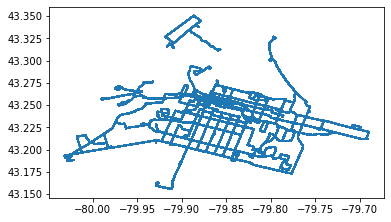

In [39]:
hamilton_shp_data_new_gpdf.plot()

In [40]:
hamilton_shp_data_new_gpdf = hamilton_shp_data_new_gpdf.set_crs(epsg=4326)

In [41]:
hamilton_shp_data_new.columns

Index(['Unnamed: 0', 'full_name', 'dir_id', 'dir_name', 'pattern', 'line_id',
       'line_name', 'km', 'hours_year', 'cost_year', 'minheadway',
       'maxheadway', 'minkph', 'maxkph', 'geometry', 'map_id_y', 'map_name_y',
       'stop_id', 'stop_name', 'lines', 'geometry_x', 'distmeters',
       'Direction', 'StationShortName', 'Notes on route_x', 'Route Name',
       'Route No', 'Stop Pattern', 'Schedule', 'Sequence', 'timestamp',
       'deltaT', 'Run/Station Sequence_y'],
      dtype='object')

In [42]:
hamilton_shp_data_new_gpdf.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

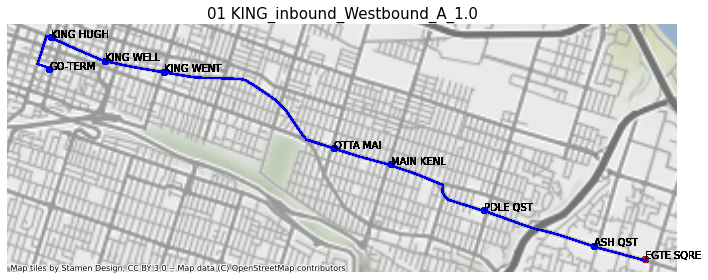

In [43]:
# Output route images
for key, group in hamilton_shp_data_new_gpdf.groupby(['line_name','dir_name','Direction','pattern','Stop Pattern']):

    
    df_line = group.iloc[:,1:19].to_crs(epsg=3857)

    df_point= group.drop(columns=['geometry'])
    df_point.rename(columns={'geometry_x':'geometry'},inplace=True)
    df_point = df_point.set_crs(epsg=4326)
    df_point = df_point.to_crs(epsg=3857)


    filenameOut = convertTuple2(key)

    ax = df_line.plot(figsize=(12, 10), alpha=0.2,color='blue')
    df_point.plot(ax=ax,color='blue')
    df_point.head(1).plot(ax=ax,color='red')
   
    ctx.add_basemap(ax,zoom=12)
    ax.set_title(filenameOut, fontsize=15)


    annote_points = df_point[df_point.StationShortName.notna()]

    for x, y, label in zip(annote_points.geometry.x, annote_points.geometry.y, annote_points.StationShortName):
        ax.annotate(xy = (x,y) , text=label)

    ax.axis('off')

    plt.savefig(r'G:\Hamilton\Data\City Model\Merged Route Images\{0}.png'.format(filenameOut),bbox_inches='tight',dpi=600)
    


# -- || Emme Model Data || -- Purpose of checking the differences between the shapfiles from the city and in the emme model

- import Emme Transit Lines, Emme Transit Line Segments, and Emme Nodes (stops) --
- Obtain the Hamilton Transit Line -- Create a convex hull of Hamilton Region using the City Shapefiles, transit lines must be completely within the convex hull
- Obtain the Hamilton Transit Line Stops (Emme Nodes) -- filter out nodes within the Hamilton Convex Hull
- Assign the nodes (stops) to each Transit Line by interesection



In [ ]:

# -- || Emme Model Data || -- Purpose of checking the differences between the shapfiles from the city and in the emme model

# -- import Emme Transit Lines, Emme Transit Line Segments, and Emme Nodes (stops) --
## Obtain the Hamilton Transit Line -- Create a convex hull of Hamilton Region using the City Shapefiles, transit lines must be completely within the convex hull
## Obtain the Hamilton Transit Line Stops (Emme Nodes) -- filter out nodes within the Hamilton Convex Hull
## Assign the nodes (stops) to each Transit Line by interesection

# -- || Compare the two shapefiles data set ||
## -- Create a buffer around the City Hamilton transit lines data set
## -- Emme stops within the buffer shapes
## -- Count number of nodes within the City Model and Emme Model
 

# -- || Compare the two shapefiles data set ||
- Create a buffer around the City Hamilton transit lines data set
- Emme stops within the buffer shapes
- Count number of nodes within the City Model and Emme Model